In [131]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score, GridSearchCV

from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import Pipeline 
from sklearn.compose import ColumnTransformer

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import Ridge

from sklearn.metrics import f1_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import r2_score 

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier, AdaBoostClassifier, GradientBoostingClassifier, StackingClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

In [49]:
dataset = pd.read_csv("conversion_data_train.csv")

# Basic stats

In [50]:
print("Number of rows : {}".format(dataset.shape[0]))
print()

print("Display of dataset: ")
display(dataset.head())
print()

print("Basics statistics: ")
data_desc = dataset.describe(include='all')
display(data_desc)
print()

print("Percentage of missing values: ")
display(100*dataset.isnull().sum()/dataset.shape[0])

Number of rows : 284580

Display of dataset: 


,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0



Basics statistics: 


,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000



Percentage of missing values: 


country                0.0
age                    0.0
new_user               0.0
source                 0.0
total_pages_visited    0.0
converted              0.0
dtype: float64

# EDA

In [51]:
features = ['converted', 'country', 'age', 'new_user', 'source', 'total_pages_visited']
for i in range(len(features)):
    fig = px.histogram(dataset[features[i]])
    fig.show()

In [52]:
# Correlation matrix
corr_matrix = dataset.corr().round(2)

import plotly.figure_factory as ff

fig = ff.create_annotated_heatmap(corr_matrix.values,
                                  x = corr_matrix.columns.tolist(),
                                  y = corr_matrix.index.tolist())


fig.show()

##### Strong correlation between conversion and the number of pages visited.

# Preprocessing

In [53]:
# Drop lines containing outliers
cols = ['age']

print('Dropping outliers in Age...')

for i in dataset[cols]:
    outlier_min = dataset[i].mean() - 2*dataset[i].std()
    outlier_max = dataset[i].mean() + 2*dataset[i].std()
    to_keep = (dataset[i] > outlier_min) & (dataset[i] < outlier_max)
    dataset = dataset.loc[to_keep,:]

print('Done. Number of lines remaining : ', dataset.shape[0])

Dropping outliers in Age...
Done. Number of lines remaining :  275778


In [54]:
# Separate target variable Y from features X
target_name = 'converted'

print("Separating labels from features...")
Y = dataset.loc[:,target_name]
X = dataset.drop(target_name, axis = 1) # All columns are kept, except the target
print("...Done.")
print(Y.head())
print()
print(X.head())
print()

Separating labels from features...
...Done.
0    0
1    0
2    1
3    0
4    0
Name: converted, dtype: int64

   country  age  new_user  source  total_pages_visited
0    China   22         1  Direct                    2
1       UK   21         1     Ads                    3
2  Germany   20         0     Seo                   14
3       US   23         1     Seo                    3
4       US   28         1  Direct                    3



In [55]:
# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0, stratify=Y)
print("...Done.")
print()

Dividing into train and test sets...
...Done.



In [56]:
# Create pipeline for numeric features
numeric_features = ["age", "total_pages_visited"]
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

# Create pipeline for categorical features
categorical_features = ['country', 'new_user', 'source'] 
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first'))
    ])

In [57]:
# Use ColumnTranformer to make a preprocessor object that describes all the treatments to be done
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Preprocessings on train set
print("Performing preprocessings on train set...")
print(X_train.head())
X_train = preprocessor.fit_transform(X_train)
print('...Done.')
print(X_train[0:5,:])
print()

# Preprocessings on test set
print("Performing preprocessings on test set...")
print(X_test.head())
X_test = preprocessor.transform(X_test)
print('...Done.')
print(X_test[0:5,:])
print()

Performing preprocessings on train set...
        country  age  new_user source  total_pages_visited
164151       US   26         1    Seo                    1
270537       US   27         1    Ads                    2
4970    Germany   32         0    Ads                    5
283377       US   17         1    Ads                    2
156292       US   47         1    Seo                    2
...Done.
[[-0.52021552 -1.15562817  0.          0.          1.          1.
   0.          1.        ]
 [-0.38651742 -0.85762281  0.          0.          1.          1.
   0.          0.        ]
 [ 0.28197303  0.03639328  1.          0.          0.          0.
   0.          0.        ]
 [-1.72349834 -0.85762281  0.          0.          1.          1.
   0.          0.        ]
 [ 2.28744441 -0.85762281  0.          0.          1.          1.
   0.          1.        ]]

Performing preprocessings on test set...
       country  age  new_user  source  total_pages_visited
277691      US   30         

# Logistic regression

In [58]:
# Train model
print("Train model...")
classifier = LogisticRegression()
classifier.fit(X_train, Y_train)
print("...Done.")

Train model...
...Done.


In [59]:
# Predictions on training set
print("Predictions on training set...")
Y_train_pred = classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]



In [60]:
# Predictions on test set
print("Predictions on test set...")
Y_test_pred = classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]



In [61]:
# Print F1 scores
print("LOGREG f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("LOGREG f1-score on test set : ", f1_score(Y_test, Y_test_pred))

f1_sc_logreg_train = f1_score(Y_train, Y_train_pred)
f1_sc_logreg_test = f1_score(Y_test, Y_test_pred)


LOGREG f1-score on train set :  0.7678801180655415
LOGREG f1-score on test set :  0.7503837887626649


In [75]:
#Tableau des scores F1_score
scores_df = pd.DataFrame(columns = ['model', 'f1_score', 'set']) 
scores_df = scores_df.append({'model': 'logreg', 'f1_score': f1_sc_logreg_train, 'set': 'train'}, ignore_index = True)  
scores_df = scores_df.append({'model': 'logreg', 'f1_score': f1_sc_logreg_test, 'set': 'test'}, ignore_index = True)  

C:\Users\DDiallo\AppData\Local\Temp\ipykernel_62036\3578842371.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\DDiallo\AppData\Local\Temp\ipykernel_62036\3578842371.py:4: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,model,f1_score,set
0,logreg,0.767880,train
1,logreg,0.750384,test


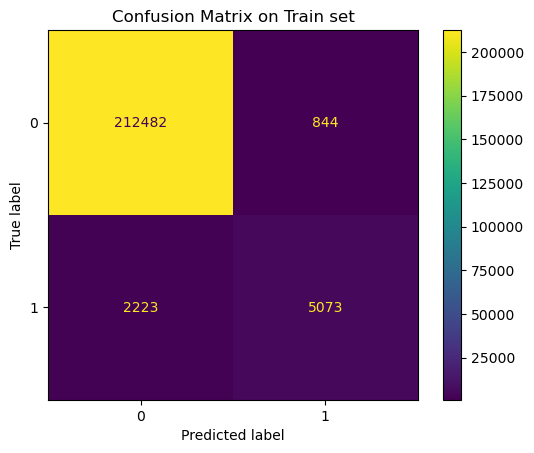

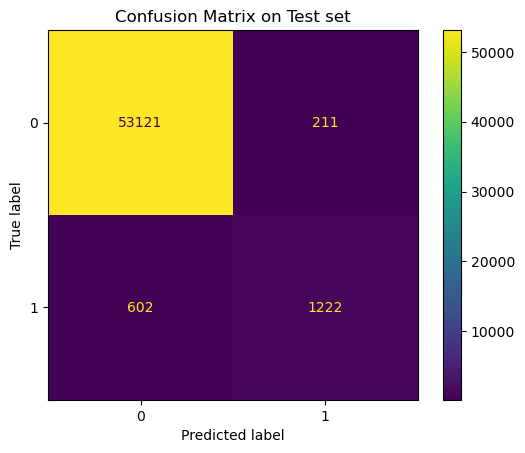

In [63]:
# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(classifier, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(classifier, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

# Decision tree

In [64]:
# Perform grid search
print("Grid search...")
classifier = DecisionTreeClassifier()

# Grid of values to be tested
params = {
    'max_depth': [4, 6, 8, 10],
    'min_samples_leaf': [1, 2, 5],
    'min_samples_split': [2, 4, 8]
}
gridsearch = GridSearchCV(classifier, param_grid = params, cv = 3) # cv : the number of folds to be used for CV
gridsearch.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)

Grid search...
...Done.
Best hyperparameters :  {'max_depth': 6, 'min_samples_leaf': 5, 'min_samples_split': 4}
Best validation accuracy :  0.984711403593935


In [65]:
# Predictions on training set
print("Predictions on training set...")
Y_train_pred = gridsearch.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on training set...")
Y_train_proba = gridsearch.predict_proba(X_train)
print("...Done.")
print(Y_train_proba)
print()

Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on training set...
...Done.
[[9.99810597e-01 1.89403379e-04]
 [9.99810597e-01 1.89403379e-04]
 [9.98661868e-01 1.33813215e-03]
 ...
 [9.97727623e-01 2.27237714e-03]
 [9.99810597e-01 1.89403379e-04]
 [9.99810597e-01 1.89403379e-04]]



In [66]:
# Predictions on test set
print("Predictions on test set...")
Y_test_pred = gridsearch.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on test set...")
Y_test_proba = gridsearch.predict_proba(X_test)
print("...Done.")
print(Y_test_proba)
print()

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on test set...
...Done.
[[9.99810597e-01 1.89403379e-04]
 [9.95218923e-01 4.78107700e-03]
 [9.99810597e-01 1.89403379e-04]
 ...
 [7.00434153e-01 2.99565847e-01]
 [9.99810597e-01 1.89403379e-04]
 [9.89740442e-01 1.02595580e-02]]



In [67]:
# Print scores
print("DECISION TREE f1-score on training set : ", f1_score(Y_train, Y_train_pred))
print("DECISION TREE f1-score on test set : ", f1_score(Y_test, Y_test_pred))
print()
f1_sc_dt_train = f1_score(Y_train, Y_train_pred)
f1_sc_dt_test = f1_score(Y_test, Y_test_pred)

DECISION TREE f1-score on training set :  0.7511573195719813
DECISION TREE f1-score on test set :  0.7363914373088685



In [2]:
#Tableau des scores F1_score
scores_df = scores_df.append({'model': 'decision_tree', 'f1_score': f1_sc_dt_train, 'set': 'train'}, ignore_index = True)  
scores_df = scores_df.append({'model': 'decision_tree', 'f1_score': f1_sc_dt_test, 'set': 'test'}, ignore_index = True)   


NameError: name 'scores_df' is not defined

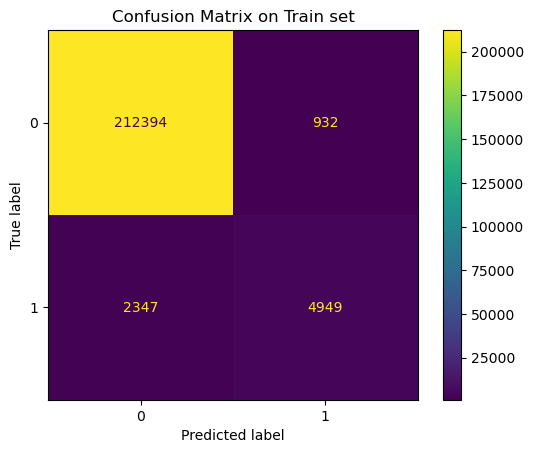

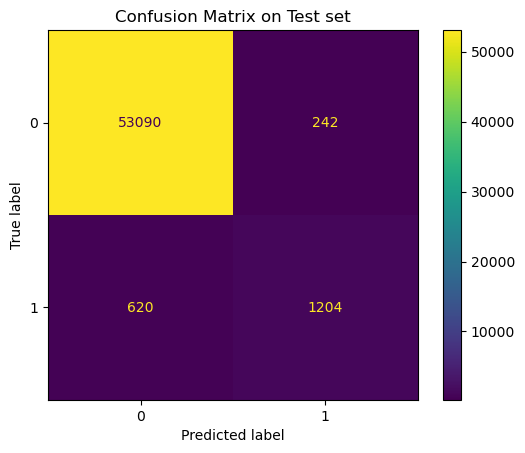

In [69]:
# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

# Random forest

In [70]:
# Perform grid search
print("Grid search...")
classifier = RandomForestClassifier()

# Grid of values to be tested
params = {
    'max_depth': [2, 6, 8],
    'min_samples_leaf': [1, 5],
    'min_samples_split': [2, 8],
    'n_estimators': [10, 60, 80]
}
gridsearch = GridSearchCV(classifier, param_grid = params, cv = 3) # cv : the number of folds to be used for CV
gridsearch.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)

Grid search...
...Done.
Best hyperparameters :  {'max_depth': 8, 'min_samples_leaf': 1, 'min_samples_split': 8, 'n_estimators': 80}
Best validation accuracy :  0.9857448452235795


In [71]:
# Predictions on training set
print("Predictions on training set...")
Y_train_pred = gridsearch.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on training set...")
Y_train_proba = gridsearch.predict_proba(X_train)
print("...Done.")
print(Y_train_proba)
print()

Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on training set...
...Done.
[[9.96220936e-01 3.77906374e-03]
 [9.96507299e-01 3.49270085e-03]
 [9.87466255e-01 1.25337450e-02]
 ...
 [9.97643661e-01 2.35633872e-03]
 [9.98805821e-01 1.19417884e-03]
 [9.99540681e-01 4.59318894e-04]]



In [72]:
# Predictions on test set
print("Predictions on test set...")
Y_test_pred = gridsearch.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on test set...")
Y_test_proba = gridsearch.predict_proba(X_test)
print("...Done.")
print(Y_test_proba)
print()

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on test set...
...Done.
[[0.99694066 0.00305934]
 [0.99507554 0.00492446]
 [0.99765455 0.00234545]
 ...
 [0.71599205 0.28400795]
 [0.99605093 0.00394907]
 [0.98879885 0.01120115]]



In [73]:
# Print scores
print("RANDOM FOREST f1-score on training set : ", f1_score(Y_train, Y_train_pred))
print("RANDOM FOREST f1-score on test set : ", f1_score(Y_test, Y_test_pred))
print()
f1_sc_rf_train = f1_score(Y_train, Y_train_pred)
f1_sc_rf_test = f1_score(Y_test, Y_test_pred)

RANDOM FOREST f1-score on training set :  0.7684532924961716
RANDOM FOREST f1-score on test set :  0.748994119467657



In [77]:
#Tableau des scores F1_score
scores_df = scores_df.append({'model': 'random_forest', 'f1_score': f1_sc_rf_train, 'set': 'train'}, ignore_index = True)  
scores_df = scores_df.append({'model': 'random_forest', 'f1_score': f1_sc_rf_test, 'set': 'test'}, ignore_index = True)  

C:\Users\DDiallo\AppData\Local\Temp\ipykernel_62036\4271998110.py:2: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\DDiallo\AppData\Local\Temp\ipykernel_62036\4271998110.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,model,f1_score,set
0,logreg,0.767880,train
1,logreg,0.750384,test
2,decision_tree,0.751157,train
3,decision_tree,0.736391,test
4,random_forest,0.768453,train
5,random_forest,0.748994,test


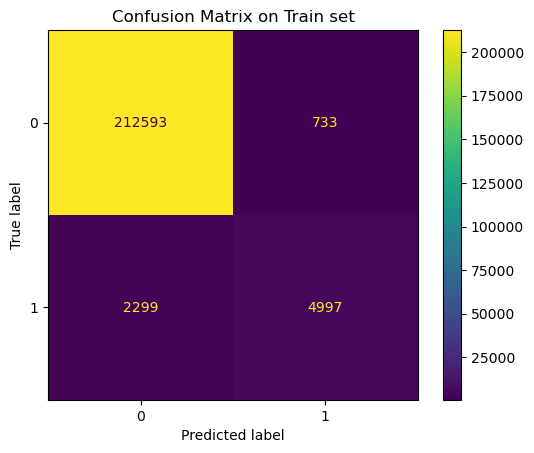

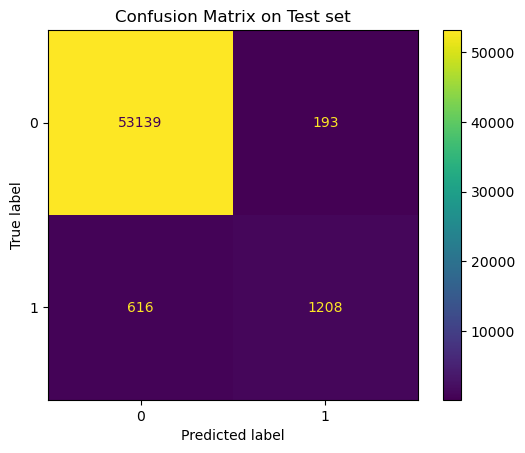

In [ ]:
# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(gridsearch, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

# AdaBoost

AdaBoost model with a logistic regression as base estimator

In [84]:
# ADABOOST LOGISTIC REGRESSION 
# Perform grid search
print("Grid search...")
logistic_regression = LogisticRegression(max_iter = 1000)
adaboost_logreg = AdaBoostClassifier(logistic_regression)

# Grid of values to be tested
params = {
    'base_estimator__C': [0.01, 0.05, 0.1, 0.5, 1.0, 5.0, 10.0, 50.0],
    'n_estimators': [5, 10, 20, 40, 60, 80, 100]
}
print(params)
gridsearch = GridSearchCV(adaboost_logreg, param_grid = params, cv = 3, verbose = 1) # cv : the number of folds to be used for CV
gridsearch.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)
print()
#print("Accuracy on training set : ", gridsearch.score(X_train, Y_train))
#print("Accuracy on test set : ", gridsearch.score(X_test, Y_test))

Grid search...
{'base_estimator__C': [0.01, 0.05, 0.1, 0.5, 1.0, 5.0, 10.0, 50.0], 'n_estimators': [5, 10, 20, 40, 60, 80, 100]}
Fitting 3 folds for each of 56 candidates, totalling 168 fits
...Done.
Best hyperparameters :  {'base_estimator__C': 5.0, 'n_estimators': 100}
Best validation accuracy :  0.9859624127842657



In [85]:
# Predictions on training set
print("Predictions on training set...")
Y_train_pred = gridsearch.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on training set...")
Y_train_proba = gridsearch.predict_proba(X_train)
print("...Done.")
print(Y_train_proba)
print()

Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on training set...
...Done.
[[0.52529081 0.47470919]
 [0.52316226 0.47683774]
 [0.51337853 0.48662147]
 ...
 [0.5177592  0.4822408 ]
 [0.52720017 0.47279983]
 [0.53595986 0.46404014]]



In [86]:
# Predictions on test set
print("Predictions on test set...")
Y_test_pred = gridsearch.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on test set...")
Y_test_proba = gridsearch.predict_proba(X_test)
print("...Done.")
print(Y_test_proba)
print()

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on test set...
...Done.
[[0.52029419 0.47970581]
 [0.51158013 0.48841987]
 [0.52404239 0.47595761]
 ...
 [0.50138385 0.49861615]
 [0.52278389 0.47721611]
 [0.51155956 0.48844044]]



In [87]:
# Print scores
print("ADABOOST LOGREG f1-score on training set : ", f1_score(Y_train, Y_train_pred))
print("ADABOOST LOGREG f1-score on test set : ", f1_score(Y_test, Y_test_pred))
print()
f1_sc_adaLogreg_train = f1_score(Y_train, Y_train_pred)
f1_sc_adaLogreg_test = f1_score(Y_test, Y_test_pred)

ADABOOST LOGREG f1-score on training set :  0.7669286577992745
ADABOOST LOGREG f1-score on test set :  0.7538978905533475



In [114]:
#Tableau des scores F1_score
scores_df = scores_df.append({'model': 'adaboost_logreg', 'f1_score': f1_sc_adaLogreg_train, 'set': 'train'}, ignore_index = True)  
scores_df = scores_df.append({'model': 'adaboost_logreg', 'f1_score': f1_sc_adaLogreg_test, 'set': 'test'}, ignore_index = True)  

C:\Users\DDiallo\AppData\Local\Temp\ipykernel_62036\2145764543.py:2: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\DDiallo\AppData\Local\Temp\ipykernel_62036\2145764543.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



AdaBoost model with a decision tree as base estimator

In [91]:
#ADABOOST DECISION TREE
# Perform grid search
print("Grid search...")
decision_tree = DecisionTreeClassifier()
adaboost_dt = AdaBoostClassifier(decision_tree)

# Grid of values to be tested
params = {
    'base_estimator__max_depth': [8, 10, 12],
    'base_estimator__min_samples_leaf': [1, 2, 3],
    'base_estimator__min_samples_split': [6, 8, 10],
    'n_estimators': [2, 4, 6, 8, 10, 12]
}
print(params)
gridsearch = GridSearchCV(adaboost_dt, param_grid = params, cv = 3, verbose = 1) # cv : the number of folds to be used for CV
gridsearch.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)
print()
#print("Accuracy on training set : ", gridsearch.score(X_train, Y_train))
#print("Accuracy on test set : ", gridsearch.score(X_test, Y_test))

Grid search...
{'base_estimator__max_depth': [8, 10, 12], 'base_estimator__min_samples_leaf': [1, 2, 3], 'base_estimator__min_samples_split': [6, 8, 10], 'n_estimators': [2, 4, 6, 8, 10, 12]}
Fitting 3 folds for each of 162 candidates, totalling 486 fits
...Done.
Best hyperparameters :  {'base_estimator__max_depth': 8, 'base_estimator__min_samples_leaf': 3, 'base_estimator__min_samples_split': 6, 'n_estimators': 2}
Best validation accuracy :  0.9851057444663917



In [92]:
# Predictions on training set
print("Predictions on training set...")
Y_train_pred = gridsearch.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on training set...")
Y_train_proba = gridsearch.predict_proba(X_train)
print("...Done.")
print(Y_train_proba)
print()

Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on training set...
...Done.
[[1.00000000e+00 1.25539394e-10]
 [9.91413963e-01 8.58603656e-03]
 [9.68896889e-01 3.11031109e-02]
 ...
 [9.81622707e-01 1.83772934e-02]
 [1.00000000e+00 4.23481784e-10]
 [1.00000000e+00 1.25539394e-10]]



In [93]:
# Predictions on test set
print("Predictions on test set...")
Y_test_pred = gridsearch.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on test set...")
Y_test_proba = gridsearch.predict_proba(X_test)
print("...Done.")
print(Y_test_proba)
print()

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on test set...
...Done.
[[0.99141396 0.00858604]
 [0.92763575 0.07236425]
 [0.99141396 0.00858604]
 ...
 [0.58665294 0.41334706]
 [0.99141396 0.00858604]
 [0.87830005 0.12169995]]



In [94]:
# Print scores
print("ADABOOST DT f1-score on training set : ", f1_score(Y_train, Y_train_pred))
print("ADABOOST DT f1-score on test set : ", f1_score(Y_test, Y_test_pred))
print()
f1_sc_adaDT_train = f1_score(Y_train, Y_train_pred)
f1_sc_adaDT_test = f1_score(Y_test, Y_test_pred)

ADABOOST DT f1-score on training set :  0.7736955392266013
ADABOOST DT f1-score on test set :  0.7555422408627921



In [113]:
#Tableau des scores F1_score
scores_df = scores_df.append({'model': 'adaboost_DT', 'f1_score': f1_sc_adaDT_train, 'set': 'train'}, ignore_index = True)  
scores_df = scores_df.append({'model': 'adaboost_DT', 'f1_score': f1_sc_adaDT_test, 'set': 'test'}, ignore_index = True)   

C:\Users\DDiallo\AppData\Local\Temp\ipykernel_62036\2120162776.py:2: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\DDiallo\AppData\Local\Temp\ipykernel_62036\2120162776.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



# Gradient Boosting

In [96]:
# GRADIENT BOOSTING 
# Perform grid search
print("Grid search...")
gradientboost = GradientBoostingClassifier()

# Grid of values to be tested
params = {
    'max_depth': [8, 10, 12],
    'min_samples_leaf': [1, 2, 3],
    'min_samples_split': [6, 8, 10],
    'n_estimators': [2, 4, 6, 8, 10, 12]
}
print(params)
gridsearch = GridSearchCV(gradientboost, param_grid = params, cv = 3, verbose = 1) # cv : the number of folds to be used for CV
gridsearch.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)
print()
#print("Accuracy on training set : ", gridsearch.score(X_train, y_train))
#print("Accuracy on test set : ", gridsearch.score(X_test, y_test))

Grid search...
{'max_depth': [8, 10, 12], 'min_samples_leaf': [1, 2, 3], 'min_samples_split': [6, 8, 10], 'n_estimators': [2, 4, 6, 8, 10, 12]}
Fitting 3 folds for each of 162 candidates, totalling 486 fits
...Done.
Best hyperparameters :  {'max_depth': 8, 'min_samples_leaf': 1, 'min_samples_split': 6, 'n_estimators': 12}
Best validation accuracy :  0.9847793950360396



In [97]:
# Predictions on training set
print("Predictions on training set...")
Y_train_pred = gridsearch.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on training set...")
Y_train_proba = gridsearch.predict_proba(X_train)
print("...Done.")
print(Y_train_proba)
print()

Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on training set...
...Done.
[[0.98998407 0.01001593]
 [0.98997776 0.01002224]
 [0.98855427 0.01144573]
 ...
 [0.98919869 0.01080131]
 [0.98977405 0.01022595]
 [0.99001018 0.00998982]]



In [98]:
# Predictions on test set
print("Predictions on test set...")
Y_test_pred = gridsearch.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on test set...")
Y_test_proba = gridsearch.predict_proba(X_test)
print("...Done.")
print(Y_test_proba)
print()

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on test set...
...Done.
[[0.98997776 0.01002224]
 [0.98639423 0.01360577]
 [0.98997776 0.01002224]
 ...
 [0.70014853 0.29985147]
 [0.98997776 0.01002224]
 [0.9817386  0.0182614 ]]



In [99]:
# Print scores
print("Gradient Boost f1-score on training set : ", f1_score(Y_train, Y_train_pred))
print("Gradient Boost f1-score on test set : ", f1_score(Y_test, Y_test_pred))
print()
f1_sc_GradientBoost_train = f1_score(Y_train, Y_train_pred)
f1_sc_GradientBoost_test = f1_score(Y_test, Y_test_pred)

Gradient Boost f1-score on training set :  0.7496959377280467
Gradient Boost f1-score on test set :  0.7197389885807505



In [115]:
#Tableau des scores F1_score
scores_df = scores_df.append({'model': 'gradient_boost', 'f1_score': f1_sc_GradientBoost_train, 'set': 'train'}, ignore_index = True)  
scores_df = scores_df.append({'model': 'gradient_boost', 'f1_score': f1_sc_GradientBoost_test, 'set': 'test'}, ignore_index = True)  

C:\Users\DDiallo\AppData\Local\Temp\ipykernel_62036\98967512.py:2: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\DDiallo\AppData\Local\Temp\ipykernel_62036\98967512.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



# XGBoost

In [101]:
#XG BOOST
# Perform grid search
print("Grid search...")
xgboost = XGBClassifier()

# Grid of values to be tested
params = {
    'max_depth': [4, 6, 8, 10],
    'min_child_weight': [1, 2, 4, 6, 8],
    'n_estimators': [2, 4, 6, 8, 10, 12]
}
print(params)
gridsearch = GridSearchCV(xgboost, param_grid = params, cv = 3, verbose = 1) # cv : the number of folds to be used for CV
gridsearch.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)
print()
#print("Accuracy on training set : ", gridsearch.score(X_train, y_train))
#print("Accuracy on test set : ", gridsearch.score(X_test, y_test))

Grid search...
{'max_depth': [4, 6, 8, 10], 'min_child_weight': [1, 2, 4, 6, 8], 'n_estimators': [2, 4, 6, 8, 10, 12]}
Fitting 3 folds for each of 120 candidates, totalling 360 fits
...Done.
Best hyperparameters :  {'max_depth': 6, 'min_child_weight': 4, 'n_estimators': 12}
Best validation accuracy :  0.9858128356795283



In [102]:
# Predictions on training set
print("Predictions on training set...")
Y_train_pred = gridsearch.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on training set...")
Y_train_proba = gridsearch.predict_proba(X_train)
print("...Done.")
print(Y_train_proba)
print()

Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on training set...
...Done.
[[0.9874888  0.01251117]
 [0.9874888  0.01251117]
 [0.9865042  0.01349581]
 ...
 [0.9864366  0.01356337]
 [0.9874888  0.01251117]
 [0.9874888  0.01251117]]



In [103]:
# Predictions on test set
print("Predictions on test set...")
Y_test_pred = gridsearch.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# It's also possible to get the probabilities estimated by the model:
print("Probabilities on test set...")
Y_test_proba = gridsearch.predict_proba(X_test)
print("...Done.")
print(Y_test_proba)
print()

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]

Probabilities on test set...
...Done.
[[0.9874888  0.01251117]
 [0.98188394 0.01811608]
 [0.9874888  0.01251117]
 ...
 [0.6531793  0.3468207 ]
 [0.9874888  0.01251117]
 [0.97649765 0.02350236]]



In [104]:
# Print scores
print("xgboost DT f1-score on training set : ", f1_score(Y_train, Y_train_pred))
print("xgboost DT f1-score on test set : ", f1_score(Y_test, Y_test_pred))
print()
f1_sc_xgboost_train = f1_score(Y_train, Y_train_pred)
f1_sc_xgboost_test = f1_score(Y_test, Y_test_pred)

xgboost DT f1-score on training set :  0.7681061119903534
xgboost DT f1-score on test set :  0.7534288326729655



In [112]:
#Tableau des scores F1_score
scores_df = scores_df.append({'model': 'xgboost', 'f1_score': f1_sc_xgboost_train, 'set': 'train'}, ignore_index = True)  
scores_df = scores_df.append({'model': 'xgboost', 'f1_score': f1_sc_xgboost_test, 'set': 'test'}, ignore_index = True)  

C:\Users\DDiallo\AppData\Local\Temp\ipykernel_62036\3159847419.py:2: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\DDiallo\AppData\Local\Temp\ipykernel_62036\3159847419.py:3: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,model,f1_score,set
0,adaboost_DT,0.773696,train
1,random_forest,0.768453,train
2,xgboost,0.768106,train
3,logreg,0.767880,train
4,adaboost_logreg,0.766929,train
5,decision_tree,0.751157,train
6,gradient_boost,0.749696,train
7,adaboost_DT,0.755542,test
8,adaboost_logreg,0.753898,test
9,xgboost,0.753429,test


# Comparison of all the models

GRAPHIC

In [1]:
scores_df = scores_df.sort_values(by = ['set', 'f1_score'], ascending = False)
scores_df

NameError: name 'scores_df' is not defined

In [106]:
px.bar(scores_df, x = "model", y = 'f1_score', color = 'set', barmode = 'group', width = 900)

Export data in a CSV file (ADABOOST LOGREG)

In [116]:
# Concatenate our train and test set to train your best classifier on all data with labels
X = np.append(X_train,X_test,axis=0)
Y = np.append(Y_train,Y_test)

adaboost_logreg.fit(X,Y) 

AdaBoostClassifier(base_estimator=LogisticRegression(max_iter=1000))

In [117]:
# Read data without labels
data_without_labels = pd.read_csv('conversion_data_test.csv')
print('Prediction set (without labels) :', data_without_labels.shape)

# Warning : check consistency of features_list (must be the same than the features 
# used by your best classifier
features_list = ['country', 'age', 'new_user', 'source', 'total_pages_visited']
X_without_labels = data_without_labels.loc[:, features_list]

# Convert pandas DataFrames to numpy arrays before using scikit-learn
#print("Convert pandas DataFrames to numpy arrays...")
#X_without_labels = X_without_labels.values
#print("...Done")

print(X_without_labels.head())

Prediction set (without labels) : (31620, 5)
  country  age  new_user  source  total_pages_visited
0      UK   28         0     Seo                   16
1      UK   22         1  Direct                    5
2   China   32         1     Seo                    1
3      US   32         1     Ads                    6
4   China   25         0     Seo                    3


In [118]:
# WARNING : PUT HERE THE SAME PREPROCESSING AS FOR YOUR TEST SET
# CHECK YOU ARE USING X_without_labels
print("Encoding categorical features and standardizing numerical features...")

X_without_labels = preprocessor.transform(X_without_labels)
print("...Done")

Encoding categorical features and standardizing numerical features...
...Done


In [119]:
# Make predictions and dump to file
# WARNING : MAKE SURE THE FILE IS A CSV WITH ONE COLUMN NAMED 'converted' AND NO INDEX !
# WARNING : FILE NAME MUST HAVE FORMAT 'conversion_data_test_predictions_[name].csv'
# where [name] is the name of your team/model separated by a '-'
# For example : [name] = AURELIE-model1
data = {
    'converted': adaboost_logreg.predict(X_without_labels)
}

Y_predictions = pd.DataFrame(columns=['converted'],data=data)
Y_predictions.to_csv('conversion_data_test_predictions_Dalanda-model3.csv', index=False)